## Importing the libraries

In [1]:
!pip install google-generativeai

from kaggle import api
from IPython.display import display
from IPython.display import Markdown

import pathlib
import textwrap

with open('./apikey', 'r') as keyFile:
    apikey = keyFile.readline().strip()

def to_markdown(text):
    text = text.replace('•', '  *')
    return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))


In [2]:
# Get the API key from here: https://ai.google.dev/tutorials/setup
import google.generativeai as genai

genai.configure(api_key = apikey)

/Users/anishsoni/anaconda3/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
model = genai.GenerativeModel('gemini-pro')
response = model.generate_content("Why is tiger the most furious predator?")
to_markdown(response.text)

> Tigers are not the most furious predators. There is no scientific evidence to support this claim. In fact, tigers are generally considered to be ambush predators that rely on stealth and surprise to capture their prey. They are not typically known for their ferocity or aggression.

In [4]:
#viewing the response candidates
response.candidates

[index: 0
content {
  parts {
    text: "Tigers are not the most furious predators. There is no scientific evidence to support this claim. In fact, tigers are generally considered to be ambush predators that rely on stealth and surprise to capture their prey. They are not typically known for their ferocity or aggression."
  }
  role: "model"
}
finish_reason: STOP
safety_ratings {
  category: HARM_CATEGORY_SEXUALLY_EXPLICIT
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_HATE_SPEECH
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_HARASSMENT
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_DANGEROUS_CONTENT
  probability: NEGLIGIBLE
}
]

In [5]:
# If API failed to return a result, use prompt_feedback to see if it was blocked due to safety concerns regarding the prompt.
response.prompt_feedback

safety_ratings {
  category: HARM_CATEGORY_SEXUALLY_EXPLICIT
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_HATE_SPEECH
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_HARASSMENT
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_DANGEROUS_CONTENT
  probability: NEGLIGIBLE
}

## Generate text from image and text prompts using gemini-pro-vision

In [6]:
!curl -o image.jpg https://s3-us-west-1.amazonaws.com/contentlab.studiod/getty/bbf2a027d37248f0b773f4043e335625

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 7562k  100 7562k    0     0   470k      0  0:00:16  0:00:16 --:--:-- 1183k0:19  0:00:15  0:00:04  782k


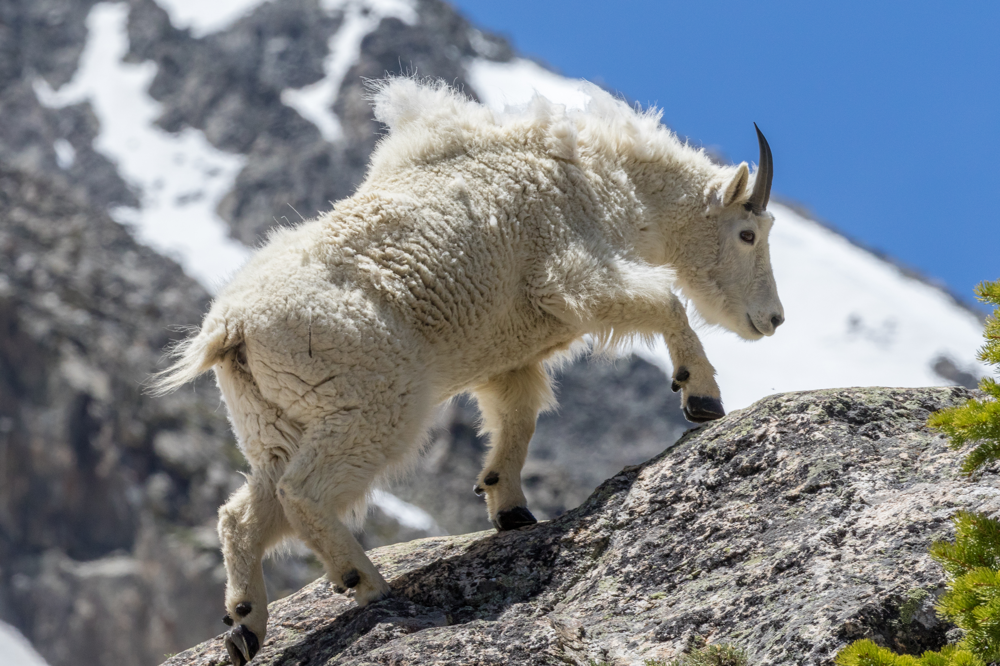

In [7]:
import PIL.Image

img = PIL.Image.open('image.jpg')
img

In [8]:
model = genai.GenerativeModel('gemini-pro-vision')

In [10]:
response = model.generate_content(img)
to_markdown(response.text)

>  A mountain goat climbs a rock.

In [11]:
response = model.generate_content(["Write a short, engaging blog post based on this picture. It should include a description of the goat in the photo and talk about it's journey.", img])
to_markdown(response.text)

>  This mountain goat is sure-footed and agile, as it scales the rocky terrain with ease. It's long, white coat is well-suited for the cold, harsh conditions of the mountains, and its sharp horns help it to maintain its balance on the steep slopes.
> 
> Mountain goats are social animals, and they often live in herds of up to 30 individuals. They are herbivores, and their diet consists mainly of grasses, leaves, and shrubs. Mountain goats are well-adapted to their environment, and they can survive in some of the most extreme conditions on Earth.
> 
> This mountain goat is just one of many that call the Rocky Mountains home. These animals are an important part of the ecosystem, and they play a vital role in maintaining the health of the mountains.